In [7]:
from simtk.openmm import *
import numpy as np
from matplotlib import pyplot as plt
from matplotlib import animation
from tqdm.notebook import tqdm
from IPython.display import HTML
import matplotlib.animation as animation
import matplotlib as matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128
import numba

In [13]:
#Animation helper to create springs
#Link: https://github.com/nrsyed/utilities/tree/master/spring
def spring(start, end, nodes, width):
    # Check that nodes is at least 1.
    nodes = max(int(nodes), 1)

    # Convert to numpy array to account for inputs of different types/shapes.
    start, end = np.array(start).reshape((2,)), np.array(end).reshape((2,))

    # If both points are coincident, return the x and y coords of one of them.
    if (start == end).all():
        return start[0], start[1]

    # Calculate length of spring (distance between endpoints).
    length = np.linalg.norm(np.subtract(end, start))

    # Calculate unit vectors tangent (u_t) and normal (u_t) to spring.
    u_t = np.subtract(end, start) / length
    u_n = np.array([[0, -1], [1, 0]]).dot(u_t)

    # Initialize array of x (row 0) and y (row 1) coords of the nodes+2 points.
    spring_coords = np.zeros((2, nodes + 2))
    spring_coords[:,0], spring_coords[:,-1] = start, end

    # Check that length is not greater than the total length the spring
    # can extend (otherwise, math domain error will result), and compute the
    # normal distance from the centerline of the spring.
    normal_dist = math.sqrt(max(0, width**2 - (length**2 / nodes**2))) / 2

    # Compute the coordinates of each point (each node).
    for i in range(1, nodes + 1):
        spring_coords[:,i] = (
            start
            + ((length * (2 * i - 1) * u_t) / (2 * nodes))
            + (normal_dist * (-1)**i * u_n))

    return spring_coords[0,:], spring_coords[1,:]

#Generate Halton sequence
def halton(i,b):
    r,f = 0,1
    while i > 0:
        f = f / b
        r = r + f*(np.mod(i,b))
        i = i // b
    return r

#Place N particles in a square box of [Lx,Ly]
#using Halton sequence
def initialize(N, Lx, Ly, b1=2, b2=3):
    x = np.zeros((N,3))
    for i in range(N):
        x[i,0] = Lx * halton(i+1,b1)
        x[i,1] = Ly * halton(i+1,b2)
    return x

#@numba.jit
def periodic_distance(r,dims):
    if np.abs(r[0]) > dims[0]/2:
        r[0] = dims[0] - r[0]
    if np.abs(r[1]) > dims[1]/2:
        r[1] = dims[1] - r[1]
    return np.linalg.norm(r)

#Perhaps there's a better name for this integrator
def DumbIntegrator(timestep=0.001,gamma=1):
    integrator = CustomIntegrator(timestep)
    
    #Friction coefficient
    integrator.addGlobalVariable("gamma",gamma)
    #Gaussian random variable
    integrator.addPerDofVariable("rand",0)
    #Velocity increment
    integrator.addPerDofVariable("dv",0)
    #Active force
    integrator.addPerDofVariable("lamb",0)
    
######Unused variables for computing action########
#    integrator.addPerDofVariable("dUi",0)
#    integrator.addGlobalVariable("dU",0)
#    integrator.addGlobalVariable("U",0)
#    integrator.addGlobalVariable("t",0)
######Unused variables for computing action########

    integrator.addUpdateContextState()
    integrator.addComputePerDof("lamb","f1")
    #Apply transformation matrix to get perpendicular vector in 2D
    #Perpendicular vector = [-r_y,r_x,0]
    integrator.addComputePerDof("lamb","10*vector(-_y(lamb),_x(lamb),0)")
    integrator.addComputePerDof("rand","gaussian*vector(1,1,0)")
    #Underdamped equation integration with gamma=1,kBT=1
    integrator.addComputePerDof("dv","(f0/m - v*gamma + lamb/m)*dt + rand * sqrt(2*dt*gamma)")
    integrator.addComputePerDof("v","v + dv")
    integrator.addComputePerDof("x","x + v*dt")
    
######Unused functions for computing action#######
#    integrator.addComputePerDof("dUi","dt*(lamb^2 - 2*lamb*(dxy/dt - f0 - v0*v))")
#    integrator.addComputePerDof("dUi" ,"(dxy/dt - f/m * vector(1,1,0) - v0*v)^2 * dt")
#    integrator.addComputeSum("dU","gamma*dUi/(4)")
#    integrator.addComputeGlobal("U","U + dU")
#    integrator.addComputeGlobal("t","t+dt")
######Unused functions for computing action#######

    return integrator

In [14]:
N        = 160 #Number of particles
a        = np.array([20,0.0,0.0]) #x dimension
b        = np.array([0.0,20,0.0]) #y dimension
c        = np.array([0.0,0.0,10]) #arbitrary z dimension
dims     = np.array([a[0],b[1]])
nsteps   = 100000 #total steps
ntraj    = 1000 #total configurations saved
dtraj    = nsteps//ntraj #step between saved configurations
x        = np.zeros((ntraj,N,2)) #trajectory
platform = openmm.Platform.getPlatformByName("CPU") #Platform

# Define the system properties
system   = System()
system.setDefaultPeriodicBoxVectors(a,b,c)
for i in range(N):
    system.addParticle(1)
    
#Initialization of the system
#Generating N/2 particles from Halton sequence
#And then drawing a random angle to place the other N/2 bonded particles
#with a check that ensures there's no particle overlap
temp = initialize(N//2,a[0],b[1])
x0   = np.zeros((N,3))
for i in tqdm(range(N//2),desc='Placing particles without overlap'):
    x0[2*i]  = temp[i]
    flag     = False
    while not flag:
        flag    = True
        theta   = np.random.random()*2*np.pi
        tmp_pos = np.array([x0[2*i,0] + np.cos(theta),x0[2*i,1] + np.sin(theta)])
        for j in range(0,2*i):
            dist  = periodic_distance(tmp_pos - x0[j,:2],dims) 
            flag  = flag*(dist>2**(1/6))  
        if flag:
            x0[2*i+1,0] = tmp_pos[0]
            x0[2*i+1,1] = tmp_pos[1]
    
#Nonbonded WCA potential with epsilon=10
eps      = 10
nb_expr  = '4.0*{:.2f}*((1/r)^12 - (1/r)^6+1/4)'.format(eps)
nb_force = CustomNonbondedForce(nb_expr)
for i in range(N):
    nb_force.addParticle([])
nb_force.setNonbondedMethod(CustomNonbondedForce.CutoffPeriodic)
nb_force.setCutoffDistance(2**(1/6)) 
system.addForce(nb_force)

#Harmonic Potential with k=100,r0=1
r0         = 1
k          = 100
bond_expr  = "{:.2f}*(r-{:.2f})^2".format(k,r0)
bond_force = CustomBondForce(bond_expr)
for i in range(int(N//2)):
    bond_force.addBond(2*i,2*i+1)
bond_force.setForceGroup(0)
system.addForce(bond_force)

#Active nonconservative force helper
#For particle i, it computes: (dr/dx_i,dr/dy_i,0)   
nc_force = CustomBondForce("r")
for i in range(int(N//2)):
    nc_force.addBond(2*i,2*i+1)
nc_force.setForceGroup(1)
system.addForce(nc_force)

#Center of mass motion remover
com_remove = CMMotionRemover()
com_remove.setForceGroup(0)
system.addForce(com_remove);

In [15]:
#Minimize 
#Note: if the system blows up(particles coordinates is nan)
#      rerun, or set N to a smaller number

integrator = DumbIntegrator()
context    = Context(system,integrator,platform)
context.setPositions(x0)
context.setVelocities(np.zeros((N,3))) #Start with 0 velocites

#Run minimization 1
integrator.setStepSize(0.00001) 
integrator.setGlobalVariableByName('gamma',0) 
integrator.step(25000) 
print("Done Minimization 1")

#Run minimization 2
integrator.setStepSize(0.00005) 
integrator.setGlobalVariableByName('gamma',0) 
integrator.step(25000) 
print("Done Minimization 2")

#Run minimization 3
integrator.setStepSize(0.00005) 
integrator.setGlobalVariableByName('gamma',0.5) 
integrator.step(25000) 
print("Done Minimization 3")

#Run minimization 4
integrator.setStepSize(0.0005) 
integrator.setGlobalVariableByName('gamma',1) 
integrator.step(25000) 
print("Done Minimization 4")

Done Minimization 1
Done Minimization 2
Done Minimization 3
Done Minimization 4


In [16]:
#Production
integrator.setStepSize(0.0005) #set dt=0.001
integrator.setGlobalVariableByName('gamma',1) #set gamma=1
#Run the simulation
bar = tqdm(total = nsteps,desc='Production MD')
for i in range(ntraj):
    integrator.step(dtraj)
    bar.update(dtraj)
    state = context.getState(getPositions=True,enforcePeriodicBox=True)
    x[i]  = np.array(state.getPositions()._value)[:,:2]

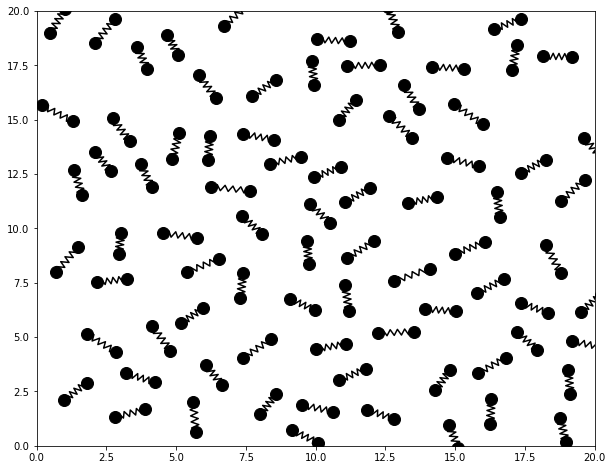

In [17]:
#Visualize trajectory
fig,ax = plt.subplots(figsize=(10,8))
ln = []
bb, = ax.plot(x[0,:,0],x[0,:,1],'ok',ms=12)
for i in range(N//2):
    a,b= spring(x[0,i*2,:2],x[0,i*2+1,:2],10,0.3)
    tmp, = ax.plot(a,b,'-k')
    plt.xlim(0,20)
    plt.ylim(0,20)
    ln.append(tmp)
def animate(i):
    bb.set_xdata(x[i,:,0])
    bb.set_ydata(x[i,:,1])
    for j in range(N//2):
        
        a,b= spring(x[i,j*2,:2],x[i,j*2+1,:2],10,0.3)
        ln[j].set_xdata(a)
        ln[j].set_ydata(b)
    return ln[0],
ani = animation.FuncAnimation(
    fig, animate,range(0,ntraj,2),interval=60, blit=True)
HTML(ani.to_jshtml())